In [1]:
import os, sys
import h5py
import numpy as np
import scipy as sp
from astropy import constants as const
import matplotlib.pyplot as plt
import units as un
from skimage.measure import block_reduce
import plotly.graph_objects as go
from analyze3d import data

import yt
from yt.funcs import mylog
mylog.setLevel(40)

%matplotlib notebook
%matplotlib inline

/u/lgaertner/miniconda3/lib/python3.9/_collections_abc.py:684: MatplotlibDeprecationWarning: The global colormaps dictionary is no longer considered public API.
  self[key]


### Plot Mesh

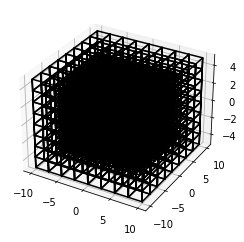

In [20]:
os.chdir("/u/lgaertner/BINARY/RUN_DIR/")
%run ~/BINARY/CODE_DIR/athena/vis/python/plot_mesh.py -i mesh_structure.dat -o mesh.png

### Check file content

In [2]:
os.chdir("/u/lgaertner/BINARY/RUN_DIR/outputSMR3Dllong/")
#os.chdir("/u/lgaertner/RUN_DIR/outputSMR/")
print(os.getcwd())
hdf5files = np.sort([f for f in os.listdir(os.getcwd()) if f.endswith(".athdf") and f.startswith("cbd.out1")])
print(hdf5files)
for f in hdf5files:
    print(f)
    file = h5py.File(f, "r")
    print(file.keys())
    for key in file.keys():
        print(key, file[key])
    break

/ccas/u/lgaertner/BINARY/RUN_DIR/outputSMR3Dllong
['cbd.out1.00000.athdf' 'cbd.out1.00001.athdf' 'cbd.out1.00002.athdf'
 'cbd.out1.00003.athdf' 'cbd.out1.00004.athdf' 'cbd.out1.00005.athdf'
 'cbd.out1.00006.athdf' 'cbd.out1.00007.athdf' 'cbd.out1.00008.athdf'
 'cbd.out1.00009.athdf' 'cbd.out1.00010.athdf' 'cbd.out1.00011.athdf'
 'cbd.out1.00012.athdf']
cbd.out1.00000.athdf
<KeysViewHDF5 ['Levels', 'LogicalLocations', 'prim', 'x1f', 'x1v', 'x2f', 'x2v', 'x3f', 'x3v']>
Levels <HDF5 dataset "Levels": shape (5608,), type ">i4">
LogicalLocations <HDF5 dataset "LogicalLocations": shape (5608, 3), type ">i8">
prim <HDF5 dataset "prim": shape (5, 5608, 16, 32, 32), type "<f4">
x1f <HDF5 dataset "x1f": shape (5608, 33), type "<f4">
x1v <HDF5 dataset "x1v": shape (5608, 32), type "<f4">
x2f <HDF5 dataset "x2f": shape (5608, 33), type "<f4">
x2v <HDF5 dataset "x2v": shape (5608, 32), type "<f4">
x3f <HDF5 dataset "x3f": shape (5608, 17), type "<f4">
x3v <HDF5 dataset "x3v": shape (5608, 16), type

### Analyse and plot data

In [3]:
#Define the units
mbin = 3. #M_sun
abin = 50. #AU
u = un.units(mbin, abin)

In [4]:
#os.chdir("/u/lgaertner/RUN_DIR/outputSMR3D/isothermal")
os.chdir("/u/lgaertner/BINARY/RUN_DIR/outputSMR3Dllong")
#os.chdir("/u/lgaertner/RUN_DIR/outputSMR/")
#unit_sys = yt.UnitSystem("disk","20.*AU", "Msun", "Myr")
#yt.unit_system_registry["disk"]
prim = np.sort([f for f in os.listdir(os.getcwd()) if f.endswith(".athdf") and f.startswith("cbd.out1")])
dat = data(prim[-1:],u)

cbd.out1.00012.athdf
[('athena_pp', 'press'), ('athena_pp', 'rho'), ('athena_pp', 'vel1'), ('athena_pp', 'vel2'), ('athena_pp', 'vel3')]
(1, 512, 512, 256) (1, 512, 512, 256)


/ccas/u/lgaertner/BINARY/ANA_DIR/analyze3d.py:43: RuntimeWarning: invalid value encountered in true_divide
  self.temp = self.press/self.u.presref / (self.rho/self.u.densref) * self.u.tempref


(512, 512)


FileNotFoundError: [Errno 2] No such file or directory: '/ccas/u/lgaertner/BINARY/RUN_DIR/outputSMR3Dllong/plots/column/cbd.out1.00012_rho.png'

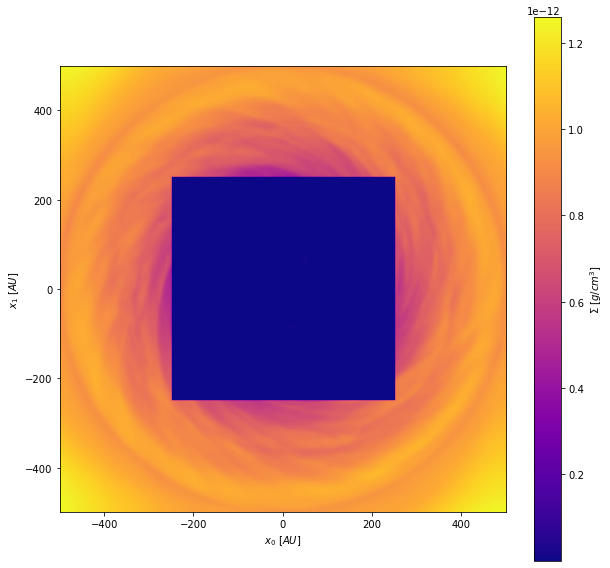

In [5]:
#dat.plot(dat.rho, "_rho.png", lab="$\Sigma ~[g/cm^3]$", low=1e-12)
dat.column_dens(1.)
dat.column_temp(1.)

In [7]:
print(dat.rho.max(), dat.rho.min(), np.mean(dat.rho))

2.0481204474458027e-10 1.425417946907699e-17 8.409472684249106e-13


In [8]:
reduced = block_reduce(dat.rho[-1], block_size=(8, 8, 8), func=np.mean)
X, Y, Z = np.mgrid[-10:10:64j, -10:10:64j, -5:5:32j]
print(np.shape(reduced))

fig = go.Figure(data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=reduced.flatten(),
    isomin=1e-12,
    #isomax=1e-12,
    opacity=0.2, # needs to be small to see through all surfaces
    surface_count=15, # needs to be a large number for good volume rendering
    ))
#fig.update_layout(scene_camera = dict(
#    up=dict(x=1, y=0, z=0),
#    center=dict(x=0, y=0, z=0),
#    eye=dict(x=1.5, y=1.5, z=1.5)
#))

fig.show()
#fig.write_image("fig1.png")

(64, 64, 32)


(512, 512, 256)
(512, 512)


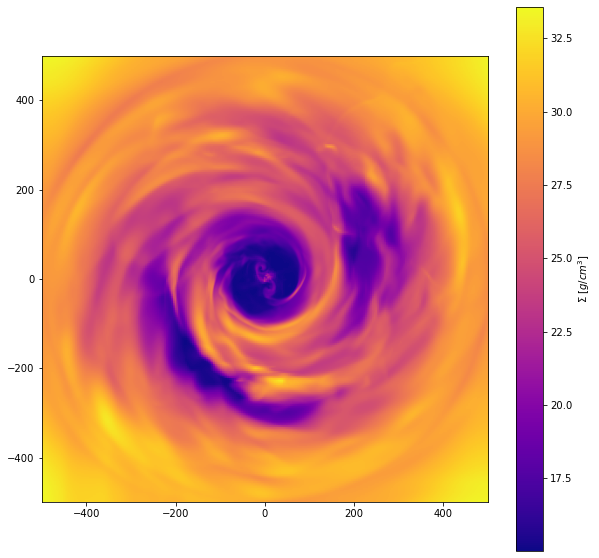

In [14]:
%matplotlib notebook
%matplotlib inline

scale = 1.

frame = u.abin * 10

column = block_reduce(dat.temp[0], block_size=(1, 1, 128), func=np.mean)[:,:,0]
print(np.shape(dat.rho[0]))
print(np.shape(column))
fig = plt.figure(figsize=(10,10))
cmap="plasma"
ax = fig.add_subplot(111)
pos = ax.imshow(column, cmap=cmap, origin='lower', extent=[-frame,frame,-frame,frame])
fig.colorbar(pos, ax=ax, label="$\Sigma ~[g/cm^3]$")

ax.set_aspect('equal', 'box')
lim = u.abin * 10. * scale
ax.set_xlim(-lim, lim)
ax.set_ylim(-lim, lim)

plt.show()

### Initial velocity  and density profile

In [10]:
def vel(rad):
    gm0             = 1.0        #binary mass
    semia           = 1.0        #binary semiaxis
    rsoft           = 0.1*semia  #?
    z               = 0.0        #height
    qrat            = 1.0        #mass ratio (secondary/primary)
    pslope          = -1.0       #?
    dslope          = -0.5       #parameter -p in paper
    p0_over_r0      = 0.01       #squared sound
    p_over_r        = p0_over_r0
    gamma_gas       = 1.0001
    alpha           = 0.1
    
    rad1 = np.sqrt((rad)**2+(rsoft)**2);
    rad2 = np.sqrt((rad)**2+(rsoft)**2+(z)**2);
    qrpl = 0.75*(semia/rad1)**2*qrat/(1.0+qrat)**2;
    vel = np.sqrt((dslope+pslope)*p_over_r + gm0*(rad/rad1)**2/rad1*(1.0+qrpl)+pslope*gm0*(1.0/rad1 -1.0/rad2))
    
    # correct with radial drift due to accretion
    vel_corr = vel- 1.5*p_over_r*gamma_gas*alpha/np.sqrt(gm0/np.sqrt((rad)**2+(rsoft)**2))

    return vel, vel_corr

def density(rad):
    rho0            = 1.0         #from paper
    dslope          = -0.5        #parameter -p in paper
    p0_over_r0      = 0.01        #squared sound speed
    p_over_r        = p0_over_r0
    gm0             = 1.0         #binary mass
    semia           = 1.0         #binary semiaxis
    r0              = semia       #as in paper
    z               = 0.0         #height
    rsoft           = 0.1*semia   #?
    rin             = 2.5         #from input file, R_s in paper
    
    denmid = rho0*(rad/r0)**dslope
    denmid *= np.exp(-(rad/rin)**(-2.0))
    dentem = denmid*np.exp(gm0/p_over_r*(1./np.sqrt((rad)**2+(rsoft)**2+(z)**2)-1./np.sqrt((rad)**2+(rsoft)**2)));
    den = dentem
    return den

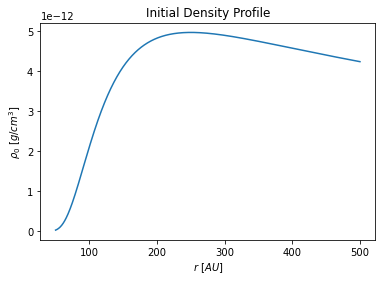

In [11]:
%matplotlib notebook
%matplotlib inline
r = np.linspace(1,10,1000) #computation only out to 10a
plt.plot(r*50.,density(r)*u.densref)
plt.ylabel(r"$\rho_0~[g/cm^3]$")
plt.xlabel("$r~[AU]$")
plt.title("Initial Density Profile")
plt.show()

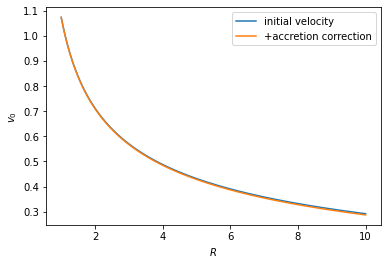

In [12]:

%matplotlib notebook
%matplotlib inline
r = np.linspace(1,10,1000) #computation only out to 10a
v, v_corr = vel(r)
plt.plot(r,v, r, v_corr)
plt.ylabel("$v_0$")
plt.xlabel("$R$")
plt.legend(['initial velocity', '+accretion correction'])
plt.show()

In [13]:

%matplotlib notebook
%matplotlib inline
l = np.shape(dat.rho[0])[0]
rad = np.zeros((l,l))
for i in range(l):
    for j in range(l):
        x = (20.*i/l-10.)
        y = (20.*j/l-10.)
        rad[i,j] = np.sqrt(x**2+y**2)
x = rad.flatten()

q= np.linspace(-10, 10, l)
grid = np.meshgrid(q,q)
rad = np.sqrt(grid[0]**2+grid[1]**2)
x = rad.flatten()*u.abin

R = dat.rho.flatten()/u.densref
P = dat.press.flatten()/u.presref
T = dat.temp.flatten()

r = np.linspace(0.01,14,1000) #computation only out to 10a
rho = density(r)#*densref

plt.loglog(x,R, 'r.')
plt.loglog(x,P, 'g.')
#plt.loglog(x,T, 'b.')
#ax.plot(x,P/R)
plt.loglog(r*u.abin,rho)


plt.xlim([1e1,1e3])
plt.ylim([1e-12,1e3])
plt.ylabel(r"$[code units]$")
plt.xlabel("$r~[AU]$")
plt.legend([r"$\rho$", r"$P$", r"$\rho$ Profile"])

plt.show()

#plt.plot(x,P, 'g.')
plt.plot(x,T, 'b.')

plt.xlim([0,400])
plt.ylabel(r"$T[K]$")
plt.xlabel("$r~[AU]$")

plt.show()

AttributeError: 'list' object has no attribute 'flatten'

### Initial temperature profile

In [ ]:
# Compute initial temp profile

def TempProfileCyl(den0):
    T0 = 15.0 #K
    temp=0
    if(den0*u.densref<1.e-12):
        temp = T0+1.5*1.e13*den0*u.densref
    elif (1.e-12 <= den0*u.densref and den0*u.densref <= 1.e-11):
        temp = (T0+15.)*(den0*u.densref*1.e12)**0.6
    elif (1.e-11 < den0*u.densref and den0*u.densref <= 3.e-9):
        temp = 10**0.6*(T0+15.)*(den0*u.densref*1.e11)**0.44
    return temp


In [ ]:
dens = np.logspace(-16, -9, 1000)
tem = [TempProfileCyl(d/u.densref) for d in dens]
plt.loglog(dens, tem, "-")
plt.xlabel(r'$\rho ~[g/cm^3]$')
plt.ylabel(r'$T ~[K]$')
plt.show()

In [ ]:
%matplotlib notebook
%matplotlib inline
x = []
y = []
for d, t in zip(dat.rho[0].flatten(), dat.temp[0].flatten()):
    x.append(d)
    y.append(t)
plt.loglog(x,y, ".")
plt.xlabel(r'$\rho ~[g/cm^3]$')
plt.ylabel(r'$T ~[K]$')
plt.ylim(10, 3e2)
dens = np.logspace(-17, -11, 1000)
tem = [TempProfileCyl(d/u.densref) for d in dens]
plt.loglog(dens, tem, "-")
plt.legend([r"data", r"model"])
plt.show()